In [1]:
""" change working directory """
import os

if os.path.basename(os.getcwd()) == 'working':
    os.chdir('../input/tf-gan-code-20181007/transparent_latent_gan_kaggle_2018_1007/transparent_latent_gan_kaggle_2018_1007')
print('current working directory is {}'.format(os.getcwd()))

current working directory is /kaggle/input/tf-gan-code-20181007/transparent_latent_gan_kaggle_2018_1007/transparent_latent_gan_kaggle_2018_1007


### Importing libraries

In [35]:
""" import packages """

import os
import glob
import sys
import cv2
import numpy as np
import pickle
import tensorflow as tf
import PIL
import io
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO
import random 

from skimage import measure

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets


import src.tf_gan.feature_celeba_organize as feature_celeba_organize

plt.rcParams["axes.grid"] = False

In [36]:
def say_something(x):
    """
    Print the current widget value in short sentence
    """
    print(f'Widget says: {x}')
 
widgets.interact(say_something, x=[0, 1, 2, 3])
widgets.interact(say_something, x=(0, 10, 1))
widgets.interact(say_something, x=(0, 10, .5))
_ = widgets.interact(say_something, x=True)

interactive(children=(Dropdown(description='x', options=(0, 1, 2, 3), value=0), Output()), _dom_classes=('widg…

interactive(children=(IntSlider(value=5, description='x', max=10), Output()), _dom_classes=('widget-interact',…

interactive(children=(FloatSlider(value=5.0, description='x', max=10.0, step=0.5), Output()), _dom_classes=('w…

interactive(children=(Checkbox(value=True, description='x'), Output()), _dom_classes=('widget-interact',))

In [37]:
!pip install flashtext
!pip install tqdm

twisted 18.7.0 requires PyHamcrest>=1.9.0, which is not installed.
mxnet 1.3.0.post0 has requirement numpy<1.15.0,>=1.8.2, but you'll have numpy 1.15.1 which is incompatible.
kmodes 0.9 has requirement scikit-learn<0.20.0,>=0.19.0, but you'll have scikit-learn 0.21.dev0 which is incompatible.
kmeans-smote 0.1.0 has requirement imbalanced-learn<0.4,>=0.3.1, but you'll have imbalanced-learn 0.4.0.dev0 which is incompatible.
kmeans-smote 0.1.0 has requirement numpy<1.15,>=1.13, but you'll have numpy 1.15.1 which is incompatible.
kmeans-smote 0.1.0 has requirement scikit-learn<0.20,>=0.19.0, but you'll have scikit-learn 0.21.dev0 which is incompatible.
keras 2.2.2 has requirement keras-applications==1.0.4, but you'll have keras-applications 1.0.5 which is incompatible.
keras 2.2.2 has requirement keras-preprocessing==1.0.2, but you'll have keras-preprocessing 1.0.3 which is incompatible.
anaconda-client 1.7.2 has requirement python-dateutil>=2.6.1, but you'll have python-dateutil 2.6.0 whi

In [5]:
from flashtext import KeywordProcessor

In [6]:
""" load learnt latent attributes for given features """
path_feature_direction = './asset_results/pg_gan_celeba_feature_direction_40'

pathfile_feature_direction = glob.glob(os.path.join(path_feature_direction, 'feature_direction_*.pkl'))[-1]

with open(pathfile_feature_direction, 'rb') as f:
    feature_direction_name = pickle.load(f)

feature_direction = feature_direction_name['direction']
feature_name = feature_direction_name['name']
num_feature = feature_direction.shape[1]

feature_name = feature_celeba_organize.feature_name_celeba_rename
feature_direction = feature_direction_name['direction']* feature_celeba_organize.feature_reverse[None, :]

In [7]:
len_z = 512
len_dummy = 0
alpha = 0.01

In [8]:
def gen_img(z=None, Gs=None):
    if z is None: 
        z = np.random.randn(len_z)
    if len(z.shape) == 1:
        z = z[None, :]
    dummy = np.zeros([z.shape[0], len_dummy])
    images = Gs.run(z, dummy)
    images = np.clip(np.rint((images + 1.0) / 2.0 * 255.0), 0.0, 255.0).astype(np.uint8)
    images = images.transpose(0, 2, 3, 1) 
    return images[0]


def save_img(img, pathfile):
    PIL.Image.fromarray(img, 'RGB').save(pathfile)


### Loading Models

In [9]:
# path to model code and weight
path_pg_gan_code = './src/model/pggan'
path_model = './asset_model/karras2018iclr-celebahq-1024x1024.pkl'
sys.path.append(path_pg_gan_code)


yn_CPU_only = False

if yn_CPU_only:
    config = tf.ConfigProto(device_count = {'GPU': 0}, allow_soft_placement=True)
else:
    config = tf.ConfigProto(allow_soft_placement=True)
    config.gpu_options.allow_growth = True

sess = tf.InteractiveSession(config=config)

with open(path_model, 'rb') as file:
    G, D, Gs = pickle.load(file)

In [10]:
Generator = Gs.clone()

In [11]:
print(Gs.print_layers())


G_paper                     Params      OutputShape             WeightShape             
---                         ---         ---                     ---                     
latents_in                  -           (?, 512)                -                       
labels_in                   -           (?, 0)                  -                       
lod                         -           ()                      -                       
4x4/PixelNorm               -           (?, 512)                -                       
4x4/Dense                   4194816     (512,)                  (512, 8192)             
4x4/Conv                    2359808     (512,)                  (3, 3, 512, 512)        
ToRGB_lod8                  1539        (3,)                    (1, 1, 512, 3)          
8x8/Upscale2D               -           (?, 512, 8, 8)          -                       
8x8/Conv0                   2359808     (512,)                  (3, 3, 512, 512)        
8x8/Conv1           

In [12]:
Attr = "5_o_Clock_Shadow Arched_Eyebrows Attractive Bags_Under_Eyes Bald Bangs Big_Lips Big_Nose Black_Hair Blond_Hair Blurry Brown_Hair Bushy_Eyebrows Chubby Double_Chin Eyeglasses Goatee Gray_Hair Heavy_Makeup High_Cheekbones Male Mouth_Slightly_Open Mustache Narrow_Eyes No_Beard Oval_Face Pale_Skin Pointy_Nose Receding_Hairline Rosy_Cheeks Sideburns Smiling Straight_Hair Wavy_Hair Wearing_Earrings Wearing_Hat Wearing_Lipstick Wearing_Necklace Wearing_Necktie Young"
Attr = Attr.split(" ")
for i in range(len(Attr)):
    Attr[i] = Attr[i].replace("_"," ")

In [13]:
latent_attribute = [feature_direction[:,i] for i in range(len(Attr))]
Idx = dict(zip(Attr, latent_attribute))

In [14]:
Attr = "5_o_Clock_Shadow Arched_Eyebrows Attractive Bags_Under_Eyes Bald Bangs Big_Lips Big_Nose Black_Hair Blond_Hair Blurry Brown_Hair Bushy_Eyebrows Chubby Double_Chin Eyeglasses Goatee Gray_Hair Heavy_Makeup High_Cheekbones Male Mouth_Slightly_Open Mustache Narrow_Eyes No_Beard Oval_Face Pale_Skin Pointy_Nose Receding_Hairline Rosy_Cheeks Sideburns Smiling Straight_Hair Wavy_Hair Wearing_Earrings Wearing_Hat Wearing_Lipstick Wearing_Necklace Wearing_Necktie Young"
Attr = Attr.split(" ")
for i in range(len(Attr)):
    Attr[i] = Attr[i].replace("_"," ").lower()

In [15]:
Attr[0]

'5 o clock shadow'

In [16]:
attr_processor = KeywordProcessor()
for i in Attr:
    attr_processor.add_keyword(i.lower())

In [17]:
import nltk 
from nltk.corpus import wordnet

In [18]:
syn = {}
ant = {}
for attr in Attr:
    synonyms = []
    antonyms = []
    for word in attr.split(' '):
        for synset in wordnet.synsets(word):
           for lemma in synset.lemmas():
               synonyms.append(lemma.name().replace("_"," "))

           if lemma.antonyms():
               antonyms.append(lemma.antonyms()[0].name().replace("_"," "))
    syn[attr] = synonyms
    ant[attr] = antonyms

In [19]:
#ant['male'] = ant['male'].append('woman')
tmp = ant['male']
tmp.append('woman')
tmp.append('lady')
tmp.append('girl')
ant['male'] = tmp
ant['male']

['female', 'androgynous', 'woman', 'lady', 'girl']

In [20]:
flist = ['female', 'androgynous', 'woman', 'lady', 'girl']

In [21]:
tmp = syn['male']
tmp.append('guy')
tmp.append('man')
tmp.append('boy')
tmp.append('fellow')
syn['male'] = tmp
syn['male']

['male',
 'male',
 'male person',
 'Male',
 'male',
 'male',
 'manful',
 'manlike',
 'manly',
 'virile',
 'male',
 'guy',
 'man',
 'boy',
 'fellow']

In [22]:
mlist = ['male',
 'male',
 'male person',
 'Male',
 'male',
 'male',
 'manful',
 'manlike',
 'manly',
 'virile',
 'male',
 'guy',
 'man',
 'boy',
 'fellow']


In [23]:
tmp = ant['young']
tmp.append('old')
tmp.append('older')
tmp.append('elderly')
ant['young'] = tmp
ant['young']

['old', 'older', 'elderly']

In [24]:
syn_processor = KeywordProcessor()
for i in syn.keys():
    for j in syn[i]:
        syn_processor.add_keyword(j.lower())

In [25]:
ant_processor = KeywordProcessor()
for i in ant.keys():
    for j in ant[i]:
        ant_processor.add_keyword(j.lower())

In [26]:
flist

['female', 'androgynous', 'woman', 'lady', 'girl']

### Generating Image

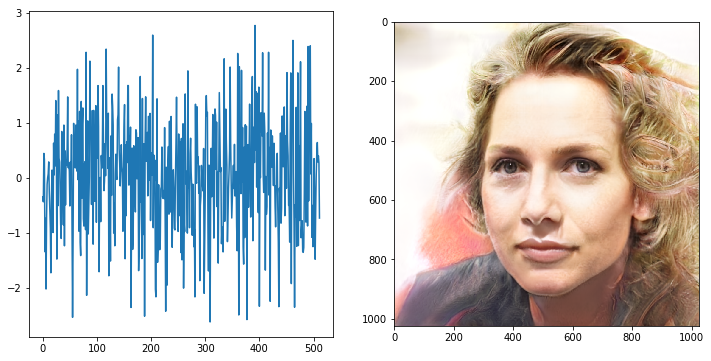

In [27]:
z = np.random.randn(512)
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12,6))
plt.sca(axs[0]); 
plt.plot(z)
plt.sca(axs[1]); 
plt.imshow(gen_img(z, Gs))

### Sample of Generated Image 

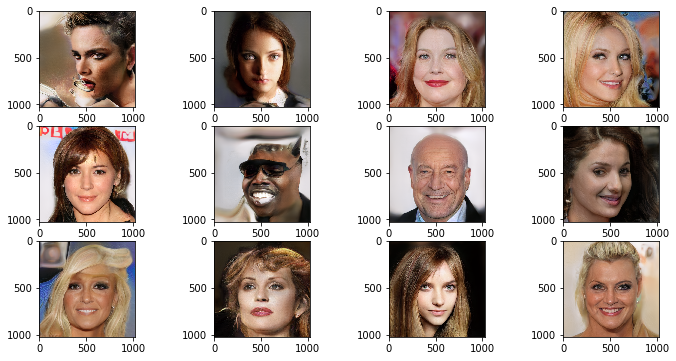

In [28]:
fig, axs = plt.subplots(nrows=3, ncols=4, figsize=(12,6))
plt.sca(axs[0][0]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[0][1]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[0][2]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[0][3]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[1][0]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[1][1]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[1][2]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[1][3]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[2][0]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[2][1]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[2][2]); 
plt.imshow(gen_img(np.random.randn(512), Gs))
plt.sca(axs[2][3]); 
plt.imshow(gen_img(np.random.randn(512), Gs))


### Attribute List

In [29]:
#latent_attribute = [feature_direction[:,i] for i in range(len(Attr))]
#Idx = dict(zip(Attr, latent_attribute))

In [30]:
text = widgets.Text(
    placeholder='Enter Description of the face!',
    description='String',
    disabled=False
)
display(text)

def callback(wdgt):
    # replace by something useful
    display(wdgt.value)

text.on_submit(callback)


Text(value='', description='String', placeholder='Enter Description of the face!')

alpha_values_positive_male = [
    -0.015, #Need to change Young # Corrected
    0.01,
    0.01,
    0.015,
    0.01, #Need to change Black Hair
    0.01, #Need to change Blond Hair
    0.01, #Need to change Brown Hair
    0.01,
    0.15, #Need to change Male
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.1 # Need to change Straight Hair
]

alpha_values_negative_male = [
    -0.015, #Need to change Young
    0.02,
    0.01,
    0.015,
    0.01, #Need to change Black Hair
    0.01, #Need to change Blond Hair
    0.01, #Need to change Brown Hair
    0.01,
    0.15, #Need to change Male
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.1 # Need to change Straight Hair
]


alpha_values_positive_female = [
    -0.015, 
    0.005,
    0.01,
    0.005,
    0.005, #Need to change Black Hair
    0.005, #Need to change Blond Hair
    0.02, #Need to change Brown Hair
    0.005,
    0.15, #Need to change Male
    0.015, #Need to change Mustache
    -0.01, 
    0.01, #Need to change No Beard
    0.01,
    -0.005,
    0.005,
    0.01
]


alpha_values_negative_female = [
    -0.015, 
    0.005,
    0.01,
    0.01,
    0.005, #Need to change Black Hair
    0.005, #Need to change Blond Hair
    0.02, #Need to change Brown Hair
    -0.015,
    0.15, #Need to change Male
    0.015,
    -0.005,
    0.01,
    0.005,
    -0.005, #Need to change Pale Skin
    0.005,
    0.01
]


In [34]:
alpha_values_positive_male = [
    0.04, 
    0.05,
    0.01,
    0.015,
    0.004, 
    0.002, 
    -0.0002,
    0.01,
    0.02, 
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.004, 
]

alpha_values_negative_male = [
    0.04, 
    0.05,
    0.01,
    0.015,
    0.0001, 
    0.0002, 
    -0.0002, 
    0.01,
    0.02, 
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.004,
]

'''
alpha_values_positive_female = [
    -0.015, 
    0.005,
    0.01,
    0.005,
    0.04, 
    -0.04, 
    0.03, 
    0.005,
    0.04, 
    0.005, 
    -0.01, 
    0.08, 
    0.01,
    -0.005,
    0.005,
    0.01
]


alpha_values_negative_female = [
    -0.015, 
    0.005,
    0.01,
    0.01,
    0.04, 
    -0.04,
    0.02, 
    -0.015,
    0.004,
    0.015,
    -0.005,
    0.01,
    0.005,
    -0.2,
    0.005,
    0.01
]
'''

'\nalpha_values_positive_female = [\n    -0.015, \n    0.005,\n    0.01,\n    0.005,\n    0.04, \n    -0.04, \n    0.03, \n    0.005,\n    0.04, \n    0.005, \n    -0.01, \n    0.08, \n    0.01,\n    -0.005,\n    0.005,\n    0.01\n]\n\n\nalpha_values_negative_female = [\n    -0.015, \n    0.005,\n    0.01,\n    0.01,\n    0.04, \n    -0.04,\n    0.02, \n    -0.015,\n    0.004,\n    0.015,\n    -0.005,\n    0.01,\n    0.005,\n    -0.2,\n    0.005,\n    0.01\n]\n'

In [35]:
alpha_values_positive_female = [
    0.015, 
    0.005,
    0.01,
    0.005,
    0.01, 
    0.01, 
    0.03, 
    0.005,
    0.04, 
    0.005, 
    0.002, 
    0.08, 
    0.01,
    0.005,
    0.002,
    0.001
]


alpha_values_negative_female = [
    0.015, 
    0.005,
    0.01,
    0.01,
    0.01, 
    0.01,
    0.02, 
    0.015,
    0.004,
    0.015,
    0.01,
    0.01,
    0.005,
    0.02,
    0.005,
    0.001
]


alpha_values_positive_male = [
    0.04, 
    0.05,
    0.04,
    0.03,
    0.04, 
    0.02, 
    -0.02,
    0.04,
    0.04, 
    0.02,
    0.02,
    -0.04,
    -0.03,
    0.03,
    0.03,
    0.004, 
]

alpha_values_negative_male = [
    0.04, 
    0.05,
    0.01,
    0.015,
    0.0001, 
    0.0002, 
    -0.0002, 
    0.01,
    0.02, 
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.004,
]


alpha_values_positive_female = [
    -0.015, 
    0.005,
    0.01,
    0.005,
    0.04, 
    -0.04, 
    0.03, 
    0.005,
    0.04, 
    0.005, 
    -0.01, 
    0.08, 
    0.01,
    -0.005,
    0.005,
    0.01
]


alpha_values_negative_female = [
    -0.015, 
    0.005,
    0.01,
    0.01,
    0.04, 
    -0.04,
    0.02, 
    -0.015,
    0.004,
    0.015,
    -0.005,
    0.01,
    0.005,
    -0.2,
    0.005,
    0.01
]

In [36]:

alpha_values_positive_male_added = [
    (-0.05 * Idx['Attractive']),
    0,
    0,
    0,
    (- 0.004 * Idx['Blond Hair']) + (0.0002 * Idx['Brown Hair']),
    0,
    0,
    0,
    (- 0.015 * Idx['Mustache']) + (0.02 * Idx['Narrow Eyes']),
    0,
    0,
    0,
    0,
    0,
    0,
    (0.01 * Idx['Brown Hair']),
]


alpha_values_negative_male_added = [
    0,
    0,
    0,
    0,
    (- 0.004 * Idx['Blond Hair']) + (0.0002 * Idx['Brown Hair']),
    0,
    0,
    0,
    (- 0.015 * Idx['Mustache']) + (0.02 * Idx['Narrow Eyes']),
    0,
    0,
    0,
    0,
    0,
    0,
    (0.01 * Idx['Brown Hair']),
]


alpha_values_positive_female_added = [
    0,
    0,
    0,
    0,
    (0.04 * Idx['Brown Hair']),
    (-0.04 * Idx['Brown Hair']),
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
]


alpha_values_negative_female_added = [
    0,
    0,
    0,
    0,
    (0.04 * Idx['Brown Hair']),
    (-0.04 * Idx['Brown Hair']),
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
]


In [37]:
values = [ Idx['Young'],
           Idx['Attractive'],
           Idx['Big Lips'],
           Idx['Big Nose'],
           Idx['Black Hair'],
           Idx['Blond Hair'],
           Idx['Brown Hair'],
           Idx['Chubby'],
           Idx['Male'],
           Idx['Mustache'],
           Idx['Narrow Eyes'],
           Idx['No Beard'],
           Idx['Oval Face'],
           Idx['Pale Skin'],
           Idx['Smiling'],
           Idx['Straight Hair'],
        ]


In [38]:
amp = []
amn = []
afp = []
afn = []
for i in range(len(values)):
    amp.append(values[i] * alpha_values_positive_male[i])
    amn.append(values[i] * alpha_values_negative_male[i])
    afp.append(values[i] * alpha_values_positive_female[i])
    afn.append(values[i] * alpha_values_negative_female[i])

values_slider = [
           age_slider.value,
           attractive_slider.value, 
           big_lips_slider.value,
           big_nose_slider.value,
           black_hair_slider.value,
           blond_hair_slider.value, 
           brown_hair_slider.value,
           chubby_slider.value, 
           male_slider.value, 
           mustache_slider.value,
           narrow_eyes_slider.value, 
           beard_slider.value,
           oval_face_slider.value,
           pale_skin_slider.value,
           smiling_slider.value,
           straight_hair_slider.value,
        ]

In [39]:
text.value

''

In [40]:
tt = 'the picture of young man with short nose and black hair'

In [41]:
attr_words = attr_processor.extract_keywords(tt)
syn_words = syn_processor.extract_keywords(tt)
ant_words = ant_processor.extract_keywords(tt)

In [42]:
attr_words, syn_words, ant_words

(['young', 'black hair'], ['young', 'man', 'nose', 'black', 'hair'], [])

In [43]:
Attr.index('black hair')

8

In [44]:
vals = []
for i in Idx.keys():
    vals.append(Idx[i])

In [45]:
npa = np.asarray(vals)

In [46]:
def reset_idx():
    global base_idx
    base_idx = np.zeros(512)
    base_idx = alpha * Idx['Black Hair'] - alpha * Idx['Pointy Nose'] + alpha * Idx['Male'] - alpha * Idx['Young']
reset_idx()

In [47]:
from PIL import Image
import requests
from io import BytesIO

In [48]:
url = 'https://thetrendhairstyle.com/wp-content/uploads/2019/04/gelled-mohawk-hairstyle-for-men.jpg'
response = requests.get(url)
img = Image.open(BytesIO(response.content))

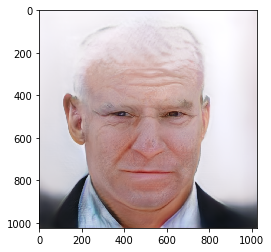

In [49]:
plt.imshow(gen_img(-Idx['Pale Skin'], Gs))

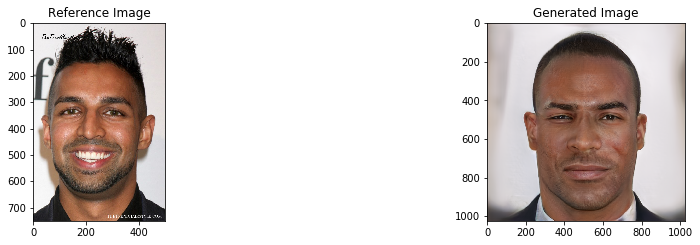

In [50]:
fig = plt.figure(figsize = (16,8))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax1.title.set_text('Reference Image')
ax2.title.set_text('Generated Image')
ax1.imshow(img)
ax2.imshow(gen_img(base_idx, Gs))
plt.show()

In [51]:
values = [ Idx['Young'],
           Idx['Attractive'],
           Idx['Big Lips'],
           Idx['Big Nose'],
           Idx['Black Hair'],
           Idx['Blond Hair'],
           Idx['Brown Hair'],
           Idx['Chubby'],
           Idx['Male'],
           Idx['Mustache'],
           Idx['Narrow Eyes'],
           Idx['No Beard'],
           Idx['Oval Face'],
           Idx['Pale Skin'],
           Idx['Smiling'],
           Idx['Straight Hair'],
        ]

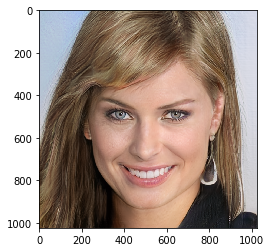

In [54]:
img = np.random.randn(len_z)
img = np.random.randn(len_z)
plt.imshow(gen_img(img, Gs))

In [55]:
alphas = [-1, -0.5, -0.1, -0.005, -0.001, 0, 1, 0.5, 0.1, 0.005, 0.001]
alphas = sorted(alphas)
alphas

[-1, -0.5, -0.1, -0.005, -0.001, 0, 0.001, 0.005, 0.1, 0.5, 1]

In [56]:
alphas = [-0.1, -0.05, -0.01, -0.0005, -0.0001, 0, 0.1, 0.05, 0.01, 0.0005, 0.0001]
alphas = sorted(alphas)
alphas

[-0.1, -0.05, -0.01, -0.0005, -0.0001, 0, 0.0001, 0.0005, 0.01, 0.05, 0.1]

In [57]:
pos = np.linspace(0,0.1,11)
neg = -1 * pos 
neg = np.delete(neg,0)
alphas = np.concatenate((pos, neg))
alphas = np.sort(alphas)
alphas

array([-0.1 , -0.09, -0.08, -0.07, -0.06, -0.05, -0.04, -0.03, -0.02,
       -0.01,  0.  ,  0.01,  0.02,  0.03,  0.04,  0.05,  0.06,  0.07,
        0.08,  0.09,  0.1 ])

In [58]:
pos = np.linspace(0,2,11)
neg = -1 * pos 
neg = np.delete(neg,0)
alphas = np.concatenate((pos, neg))
alphas = np.sort(alphas)
alphas

array([-2. , -1.8, -1.6, -1.4, -1.2, -1. , -0.8, -0.6, -0.4, -0.2,  0. ,
        0.2,  0.4,  0.6,  0.8,  1. ,  1.2,  1.4,  1.6,  1.8,  2. ])

In [59]:
values = [ Idx['Young'],
           Idx['Attractive'],
           Idx['Big Lips'],
           Idx['Big Nose'],
           Idx['Black Hair'],
           Idx['Blond Hair'],
           Idx['Brown Hair'],
           Idx['Chubby'],
           Idx['Male'],
           Idx['Mustache'],
           Idx['Narrow Eyes'],
           Idx['No Beard'],
           Idx['Oval Face'],
           Idx['Pale Skin'],
           Idx['Smiling'],
           Idx['Straight Hair'],
        ]
images = []
index_2 = 0
for attr in values:
    tmp = []
    for index, value in enumerate(alphas):
        #plt.title(f"{str(value)} {str(attr)}")
        tmp.append(gen_img(img + value * attr, Gs))
    images.append(tmp)
    index_2 += 1

In [60]:
print(len(images))
print(len(images[0]))
print(len(images[0][0]))

16
21
1024


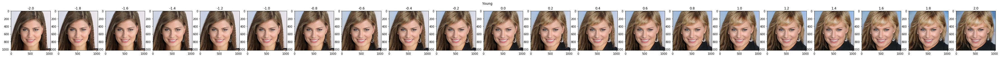

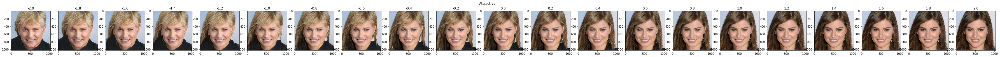

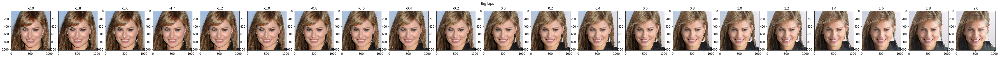

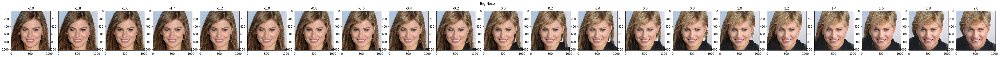

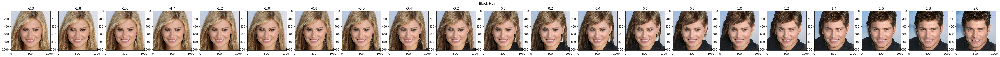

...

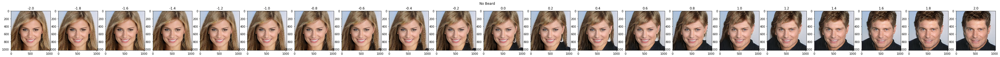

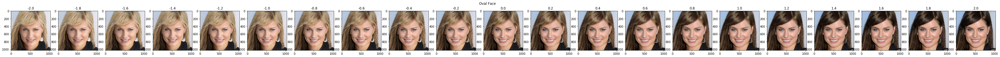

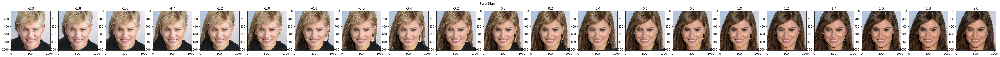

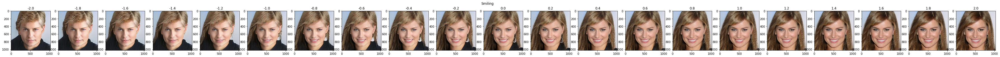

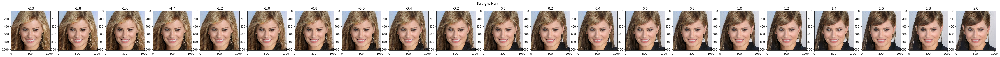

In [61]:
values_names = ['Young','Attractive','Big Lips','Big Nose','Black Hair','Blond Hair','Brown Hair','Chubby','Male','Mustache','Narrow Eyes','No Beard','Oval Face','Pale Skin','Smiling','Straight Hair']

index_1 = 0
for v_name in values_names:
    fig, axs = plt.subplots(nrows=1, ncols=21, figsize=(63,3))
    plt.suptitle(v_name)
    plt.sca(axs[0]);
    plt.title(round(alphas[0],2))
    plt.imshow(images[index_1][0])
    plt.sca(axs[1]); 
    plt.title(round(alphas[1],2)) 
    plt.imshow(images[index_1][1])
    plt.sca(axs[2]);
    plt.title(round(alphas[2],2))
    plt.imshow(images[index_1][2])
    plt.sca(axs[3]); 
    plt.title(round(alphas[3],2)) 
    plt.imshow(images[index_1][3])
    plt.sca(axs[4]);
    plt.title(round(alphas[4],2))
    plt.imshow(images[index_1][4])
    plt.sca(axs[5]); 
    plt.title(round(alphas[5],2)) 
    plt.imshow(images[index_1][5])
    plt.sca(axs[6]);
    plt.title(round(alphas[6],2))
    plt.imshow(images[index_1][6])
    plt.sca(axs[7]); 
    plt.title(round(alphas[7],2)) 
    plt.imshow(images[index_1][7])
    plt.sca(axs[8]);
    plt.title(round(alphas[8],2))
    plt.imshow(images[index_1][8])
    plt.sca(axs[9]); 
    plt.title(round(alphas[9],2)) 
    plt.imshow(images[index_1][9])
    plt.sca(axs[10]);
    plt.title(round(alphas[10],2))
    plt.imshow(images[index_1][10])
    plt.sca(axs[11]); 
    plt.title(round(alphas[11],2)) 
    plt.imshow(images[index_1][11])
    plt.sca(axs[12]);
    plt.title(round(alphas[12],2))
    plt.imshow(images[index_1][12])
    plt.sca(axs[13]); 
    plt.title(round(alphas[13], 2)) 
    plt.imshow(images[index_1][13])
    plt.sca(axs[14]);
    plt.title(round(alphas[14], 2))
    plt.imshow(images[index_1][14])
    plt.sca(axs[15]); 
    plt.title(round(alphas[15],2)) 
    plt.imshow(images[index_1][15])
    plt.sca(axs[16]);
    plt.title(round(alphas[16],2))
    plt.imshow(images[index_1][16])
    plt.sca(axs[17]); 
    plt.title(round(alphas[17],2)) 
    plt.imshow(images[index_1][17])
    plt.sca(axs[18]);
    plt.title(round(alphas[18],2))
    plt.imshow(images[index_1][18])
    plt.sca(axs[19]); 
    plt.title(round(alphas[19],2)) 
    plt.imshow(images[index_1][19])
    plt.sca(axs[20]);
    plt.title(round(alphas[20],2))
    plt.imshow(images[index_1][20])
    #plt.show()
    index_1 += 1
    plt.savefig(f"/kaggle/working/{v_name}.png")

In [63]:
!zip -r  /kaggle/working/output.zip /kaggle/working/

/bin/sh: 1: zip: not found


In [ ]:
/kaggle/working/

In [ ]:
for i in alphas:
    plt.title(i)
    plt.imshow(gen_img(img + i * values[2], Gs))
    plt.show()

In [ ]:
reset_idx()
out = widgets.Output()
def on_value_change(change):
    with out:
        print(change['new'])

gen = True # True = Male, False = Female 
text = widgets.Text(
    placeholder='Enter Description of the face!',
    description='String',
    disabled=False
)

def reset_sliders():
    age_slider.value = 0
    attractive_slider.value = 0 
    big_lips_slider.value = 0
    big_nose_slider.value = 0
    black_hair_slider.value = 0
    blond_hair_slider.value = 0 
    brown_hair_slider.value = 0
    chubby_slider.value = 0
    male_slider.value = 0
    mustache_slider.value = 0
    narrow_eyes_slider.value = 0
    beard_slider.value = 0
    oval_face_slider.value = 0
    pale_skin_slider.value = 0
    smiling_slider.value = 0
    straight_hair_slider.value = 0

def get_key(val, my_dict):
    for key, value in my_dict.items():
        for v in value:
            if val == v:
                return key

def get_arr(i):
    z = np.zeros(40)
    if i:
        ind = Attr.index(i)
        z[ind] += 1
        return z
    else:
        return z

def extract_words(tt):
    global gen
    Z = np.zeros(40)
    attr_words = attr_processor.extract_keywords(tt)
    syn_words = syn_processor.extract_keywords(tt)
    ant_words = ant_processor.extract_keywords(tt)
    
    for i in tt.split(' '):
        if i in mlist:
            gen = True
        elif i in flist:
            gen = False
        
    positive = []
    negative = []
    #print(attr_words, syn_words, ant_words)
    for i in attr_words:
        Z += 0.5 * get_arr(i)
    
    for i in syn_words:
        at = get_key(i, syn)
        Z += 0.25 * get_arr(at)
        
    for i in ant_words:
        at = get_key(i, ant)
        Z -= 1.25 * get_arr(at)
    
    return Z
        
    
Z_g = np.zeros(512)
Z_re = np.zeros(512)
Z_base = np.zeros(512)

def generate_face(b):
    global Z_g, Z_re, Z_base, gen
    Z_g = np.zeros(512)
    out.clear_output()
    out2.clear_output()
    with out:
        reset_sliders()
        z = extract_words(text.value)
        for i in range(39):
            Z_g += (vals[i] * z[i])
        Z_g -= (vals[39] * z[39])
        Z_re = Z_g.copy()
        Z_base = Z_g.copy()
        plt.imshow(gen_img(Z_g, Gs))
        plt.show()
        
def generate_face_ad(b):
    global Z_g, Z_base, Z_re
    out2.clear_output()
    with out2:
        
        value_slider = [
           age_slider.value,
           attractive_slider.value, 
           big_lips_slider.value,
           big_nose_slider.value,
           black_hair_slider.value,
           blond_hair_slider.value, 
           brown_hair_slider.value,
           chubby_slider.value, 
           male_slider.value, 
           mustache_slider.value,
           narrow_eyes_slider.value, 
           beard_slider.value,
           oval_face_slider.value,
           pale_skin_slider.value,
           smiling_slider.value,
           straight_hair_slider.value,
        ]
        
        print(len(value_slider))
        for i in range(len(value_slider)):
            '''
            if value_slider[i] > 0:
                    Z_g += (amp[i] * value_slider[i]) + (alpha_values_positive_male_added[i] * value_slider[i])
            elif value_slider[i] < 0:
                    print("neg")
                    Z_g += (amn[i] * value_slider[i]) + (alpha_values_negative_male_added[i] * value_slider[i])
            '''   
            if gen:
                if value_slider[i] > 0:
                    Z_g += (amp[i] * value_slider[i]) + (alpha_values_positive_male_added[i] * value_slider[i])
                elif value_slider[i] < 0:
                    Z_g += (amn[i] * value_slider[i]) + (alpha_values_negative_male_added[i] * value_slider[i])
            else:
                if value_slider[i] > 0:
                    Z_g += (afp[i] * value_slider[i]) + (alpha_values_positive_female_added[i] * value_slider[i])
                elif value_slider[i] < 0:
                    Z_g += (afn[i] * value_slider[i]) + (alpha_values_negative_female_added[i] * value_slider[i])

        f, axarr = plt.subplots(nrows=1,ncols=2, figsize=(12, 6))
        plt.sca(axarr[0]); 
        plt.imshow(gen_img(Z_base, Gs)); plt.title('Orignal Image')
        plt.sca(axarr[1]);
        plt.imshow(gen_img(Z_g, Gs)); plt.title('New Image')
        Z_base = Z_g.copy()
        plt.show()

btn = widgets.Button(description="Generate Image")
btn.on_click(generate_face)
out = widgets.Output()

btn2 = widgets.Button(description="Generate Image")
btn2.on_click(generate_face_ad)
out2 = widgets.Output()

def reset_face():
    global Z_g
    with out3:
        out2.clear_output()
        reset_sliders()
        Z_g = Z_re.copy()

btn3 = widgets.Button(description="Reset Image")
btn3.on_click(reset_face)
out3 = widgets.Output()


def callback(wdgt):
    # replace by something useful
    display(wdgt.value)

text.on_submit(callback)
age_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Age %', continuous_update=True)
attractive_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Attractive %', continuous_update=True)
big_lips_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Lips %', continuous_update=True)
big_nose_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Nose %', continuous_update=True)
black_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Black Hair %', continuous_update=True)
blond_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Blond Hair %', continuous_update=True)
brown_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Brown Hair %', continuous_update=True)
chubby_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Chubby Face %', continuous_update=True)
male_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Male %', continuous_update=True)
mustache_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Mustache %', continuous_update=True)
narrow_eyes_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Narrow Eyes %', continuous_update=True)
beard_slider =  widgets.IntSlider(min=-100, max=100, step=1, description="Beard %", continuous_update=True)
oval_face_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Oval Face %', continuous_update=True)
pale_skin_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Skin Color %', continuous_update=True)
smiling_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Smiling %', continuous_update=True)
straight_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Straight Hair %', continuous_update=True)


box1 = widgets.VBox([
    widgets.HBox([text, widgets.VBox([btn,out])])
])

box2 = widgets.VBox([
           age_slider,
           attractive_slider,
           big_lips_slider,
           big_nose_slider,
           black_hair_slider,
           blond_hair_slider,
           brown_hair_slider,
           chubby_slider,
           male_slider,
           #mustache_slider,
           narrow_eyes_slider,
           beard_slider,
           oval_face_slider,
           pale_skin_slider,
           smiling_slider,
           straight_hair_slider,
            widgets.VBox([btn2,out2]),
            #btn3
        ])


children = [box1, box2]
tab = widgets.Tab()
tab.children = children

tab.set_title(0, 'Text')
tab.set_title(1, 'Adjustments')

tab

Description 1: czzz

Description 2: the picture of old woman with narrow eyes and blond hair


In [ ]:
"Generate a face of blond guy with blue eyes with beard and big nose."

Description 1: the picture of young man with big nose and black hair

Description 2: the picture of old woman with narrow eyes and blond hair


the picture of young man with big nose and black hair

In [ ]:
reset_idx()
out = widgets.Output()
def on_value_change(change):
    with out:
        print(change['new'])

gen = True # True = Male, False = Female 
text = widgets.Text(
    placeholder='Enter Description of the face!',
    description='String',
    disabled=False
)

def get_key(val, my_dict):
    for key, value in my_dict.items():
        for v in value:
            if val == v:
                return key

def get_arr(i):
    z = np.zeros(40)
    if i:
        ind = Attr.index(i)
        z[ind] += 1
        return z
    else:
        return z

def extract_words(tt):
    global gen
    Z = np.zeros(40)
    attr_words = attr_processor.extract_keywords(tt)
    syn_words = syn_processor.extract_keywords(tt)
    ant_words = ant_processor.extract_keywords(tt)
    
    for i in tt.split(' '):
        if i in mlist:
            gen = True
        elif i in flist:
            gen = False
        
    positive = []
    negative = []
    print(attr_words, syn_words, ant_words)
    for i in attr_words:
        Z += 0.5 * get_arr(i)
    
    for i in syn_words:
        at = get_key(i, syn)
        Z += 0.25 * get_arr(at)
        
    for i in ant_words:
        at = get_key(i, ant)
        Z -= 1.25 * get_arr(at)
    
    return Z
        
    
Z_g = np.zeros(512)
Z_re = np.zeros(512)
Z_base = np.zeros(512)

def generate_face(b):
    global Z_g, Z_re, Z_base, gen
    Z_g = np.zeros(512)
    out.clear_output()
    with out:
        z = extract_words(text.value)
        for i in range(39):
            Z_g += (vals[i] * z[i])
        Z_g -= (vals[39] * z[39])
        Z_re = Z_g.copy()
        Z_base = Z_g.copy()
        plt.imshow(gen_img(Z_g, Gs))
        plt.show()
        
def generate_face_ad(b):
    global Z_g, Z_base, Z_re
    out2.clear_output()
    with out2:
        
        value_slider = [
           age_slider.value,
           attractive_slider.value, 
           big_lips_slider.value,
           big_nose_slider.value,
           black_hair_slider.value,
           blond_hair_slider.value, 
           brown_hair_slider.value,
           chubby_slider.value, 
           male_slider.value, 
           mustache_slider.value,
           narrow_eyes_slider.value, 
           beard_slider.value,
           oval_face_slider.value,
           pale_skin_slider.value,
           smiling_slider.value,
           straight_hair_slider.value,
        ]
        
        print(len(value_slider))
        for i in range(len(value_slider)):
            '''
            if value_slider[i] > 0:
                    Z_g += (amp[i] * value_slider[i]) + (alpha_values_positive_male_added[i] * value_slider[i])
            elif value_slider[i] < 0:
                    print("neg")
                    Z_g += (amn[i] * value_slider[i]) + (alpha_values_negative_male_added[i] * value_slider[i])
            '''   
            if gen:
                if value_slider[i] > 0:
                    Z_g += (amp[i] * value_slider[i]) + (alpha_values_positive_male_added[i] * value_slider[i])
                elif value_slider[i] < 0:
                    print("neg")
                    Z_g += (amn[i] * value_slider[i]) + (alpha_values_negative_male_added[i] * value_slider[i])
            else:
                if value_slider[i] > 0:
                    print("debug 2")
                    Z_g += (afp[i] * value_slider[i]) + (alpha_values_positive_female_added[i] * value_slider[i])
                elif value_slider[i] < 0:
                    Z_g += (afn[i] * value_slider[i]) + (alpha_values_negative_female_added[i] * value_slider[i])

        f, axarr = plt.subplots(nrows=1,ncols=2, figsize=(12, 6))
        plt.sca(axarr[0]); 
        plt.imshow(gen_img(Z_base, Gs)); plt.title('Orignal Image')
        plt.sca(axarr[1]);
        plt.imshow(gen_img(Z_g, Gs)); plt.title('New Image')
        Z_base = Z_g.copy()
        plt.show()

btn = widgets.Button(description="Generate Image")
btn.on_click(generate_face)
out = widgets.Output()

btn2 = widgets.Button(description="Generate Image")
btn2.on_click(generate_face_ad)
out2 = widgets.Output()

def reset_face():
    global Z_g
    Z_g = Z_re.copy()

btn3 = widgets.Button(description="Reset Image")
btn3.on_click(reset_face)

def callback(wdgt):
    # replace by something useful
    display(wdgt.value)

text.on_submit(callback)
age_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Age %', continuous_update=True)
attractive_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Attractive %', continuous_update=True)
big_lips_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Lips %', continuous_update=True)
big_nose_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Nose %', continuous_update=True)
black_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Black Hair %', continuous_update=True)
blond_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Blond Hair %', continuous_update=True)
brown_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Brown Hair %', continuous_update=True)
chubby_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Chubby Face %', continuous_update=True)
male_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Male %', continuous_update=True)
mustache_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Mustache %', continuous_update=True)
narrow_eyes_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Narrow Eyes %', continuous_update=True)
beard_slider =  widgets.IntSlider(min=-100, max=100, step=1, description="Beard %", continuous_update=True)
oval_face_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Oval Face %', continuous_update=True)
pale_skin_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Skin Color %', continuous_update=True)
smiling_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Smiling %', continuous_update=True)
straight_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Straight Hair %', continuous_update=True)


box1 = widgets.VBox([
    widgets.HBox([text, widgets.VBox([btn,out])])
])

box2 = widgets.VBox([
           age_slider,
           attractive_slider,
           big_lips_slider,
           big_nose_slider,
           black_hair_slider,
           blond_hair_slider,
           brown_hair_slider,
           chubby_slider,
           male_slider,
           #mustache_slider,
           narrow_eyes_slider,
           beard_slider,
           oval_face_slider,
           pale_skin_slider,
           smiling_slider,
           straight_hair_slider,
            widgets.VBox([btn2,out2]),
            btn3
        ])


children = [box1, box2]
tab = widgets.Tab()
tab.children = children

tab.set_title(0, 'Text')
tab.set_title(1, 'Adjustments')

tab

In [ ]:
the picture of young man with big nose and black hair

In [ ]:
the picture of old woman with narrow eyes and blond hair

In [ ]:
Generate a face of blond guy with eyes with beard and big nose.

In [ ]:
alpha_values_positive_male = [
    0.04, 
    0.05,
    0.01,
    0.015,
    0.004, 
    0.002, 
    -0.0002,
    0.01,
    0.02, 
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.004, 
]

alpha_values_negative_male = [
    0.04, 
    0.05,
    0.01,
    0.015,
    0.0001, 
    0.0002, 
    -0.0002, 
    0.01,
    0.02, 
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.004,
]


alpha_values_positive_female = [
    0.015, 
    0.005,
    0.01,
    0.005,
    0.01, 
    0.01, 
    0.03, 
    0.005,
    0.04, 
    0.005, 
    0.002, 
    0.08, 
    0.01,
    0.005,
    0.002,
    0.001
]


alpha_values_negative_female = [
    0.015, 
    0.005,
    0.01,
    0.01,
    0.01, 
    0.01,
    0.02, 
    0.015,
    0.004,
    0.015,
    0.01,
    0.01,
    0.005,
    0.02,
    0.005,
    0.001
]

amp = []
amn = []
afp = []
afn = []
for i in range(len(values)):
    amp.append(values[i] * alpha_values_positive_male[i])
    amn.append(values[i] * alpha_values_negative_male[i])
    afp.append(values[i] * alpha_values_positive_female[i])
    afn.append(values[i] * alpha_values_negative_female[i])

In [ ]:
alpha_values_positive_male = [
    0.04, 
    0.05,
    0.04,
    0.06,
    0.04, 
    0.03, 
    -0.02,
    0.04,
    0.04, 
    0.02,
    0.02,
    -0.04,
    -0.03,
    0.03,
    0.03,
    0.004, 
]

alpha_values_negative_male = [
    0.04, 
    0.05,
    0.01,
    0.015,
    0.01, 
    0.02, 
    -0.02, 
    0.01,
    0.02, 
    0.01,
    0.01,
    -0.01,
    -0.015,
    0.015,
    0.015,
    0.004,
]


alpha_values_positive_female = [
    -0.015, 
    0.05,
    0.01,
    0.005,
    0.04, 
    -0.04, 
    0.03, 
    0.005,
    0.04, 
    0.005, 
    -0.01, 
    0.08, 
    0.01,
    -0.005,
    0.005,
    0.01
]


alpha_values_negative_female = [
    -0.015, 
    0.05,
    0.01,
    0.01,
    0.04, 
    -0.04,
    0.02, 
    -0.015,
    0.004,
    0.015,
    -0.05,
    0.01,
    0.05,
    -0.2,
    0.05,
    0.01
]

amp = []
amn = []
afp = []
afn = []
for i in range(len(values)):
    amp.append(values[i] * alpha_values_positive_male[i])
    amn.append(values[i] * alpha_values_negative_male[i])
    afp.append(values[i] * alpha_values_positive_female[i])
    afn.append(values[i] * alpha_values_negative_female[i])

In [ ]:
base_z = Z_g
plt.plot(base_z)

In [ ]:
alpha = -0.04
for j in sliders:
    print(f"Alpha value = {alpha} and slider value is {j} for Pale Skin")
    z = base_z  + (alpha * Idx['Young'] * j)
    f, axarr = plt.subplots(nrows=1,ncols=2)
    plt.sca(axarr[0]); 
    plt.imshow(gen_img(base_z, Gs)); plt.title('Orignal Image')
    plt.sca(axarr[1]); 
    plt.imshow(gen_img(z, Gs)); plt.title('New Image')
    plt.show()

In [ ]:
sliders = range(-100,100,10)

In [ ]:
alpha = 0.05
for j in sliders:
    print(f"Alpha value = {alpha} and slider value is {j} for Attractive")
    z = base_z + (alpha * Idx['Attractive'] * j) 
    f, axarr = plt.subplots(nrows=1,ncols=2)
    plt.sca(axarr[0]); 
    plt.imshow(gen_img(base_z, Gs)); plt.title('Orignal Image')
    plt.sca(axarr[1]); 
    plt.imshow(gen_img(z, Gs)); plt.title('New Image')
    plt.show()

In [ ]:
alpha_values = []
lower = 0.005
upper = 0.025
while(lower < upper):
    alpha_values.append(round(lower,3))
    lower = lower + 0.005

In [ ]:
values = [ Idx['Young'],
           Idx['Attractive'],
           Idx['Big Lips'],
           Idx['Big Nose'],
           Idx['Black Hair'],
           Idx['Blond Hair'],
           Idx['Brown Hair'],
           Idx['Chubby'],
           Idx['Male'],
           Idx['Mustache'],
           Idx['Narrow Eyes'],
           Idx['No Beard'],
           Idx['Oval Face'],
           Idx['Pale Skin'],
           Idx['Smiling'],
           Idx['Straight Hair'],
        ]

value_names = [ 'Young',
           'Attractive',
           'Big Lips',
           'Big Nose',
           'Black Hair',
           'Blond Hair',
           'Brown Hair',
           'Chubby',
           'Male',
           'Mustache',
           'Narrow Eyes',
           'No Beard',
           'Oval Face',
           'Pale Skin',
           'Smiling',
           'Straight Hair',
        ]

reset_idx()
out = widgets.Output()
def on_value_change(change):
    with out:
        print(change['new'])

text = widgets.Text(
    placeholder='Enter Description of the face!',
    description='String',
    disabled=False
)

def get_key(val, my_dict):
    for key, value in my_dict.items():
        for v in value:
            if val == v:
                return key

def get_arr(i):
    z = np.zeros(40)
    if i:
        ind = Attr.index(i)
        z[ind] += 1
        return z
    else:
        return z

def extract_words(tt):
    Z = np.zeros(40)
    attr_words = attr_processor.extract_keywords(tt)
    syn_words = syn_processor.extract_keywords(tt)
    ant_words = ant_processor.extract_keywords(tt)
    
    positive = []
    negative = []
    print(attr_words, syn_words, ant_words)
    for i in attr_words:
        Z += 1 * get_arr(i)
    
    #for i in syn_words:
        #at = get_key(i, syn)
        #Z += 1 * get_arr(at)
        
    for i in ant_words:
        at = get_key(i, ant)
        Z -= 1.25 * get_arr(at)
    
    return Z
        
    
Z_g = np.zeros(512)
Z_re = np.zeros(512)
Z_base = np.zeros(512)

def generate_face(b):
    global Z_g, Z_re, Z_base
    out.clear_output()
    with out:
        z = extract_words(text.value)
        for i in range(39):
            Z_g += (vals[i] * z[i])
        Z_g -= (vals[39] * z[39])
        Z_re = Z_g.copy()
        Z_base = Z_g.copy()
        plt.imshow(gen_img(Z_g, Gs))
        plt.show()
        
def generate_face_ad(b):
    global Z_g, Z_base, Z_re
    out2.clear_output()
    with out2:
        values = [
           age_slider.value * Idx['Young'],
           attractive_slider.value * Idx['Attractive'],
           big_lips_slider.value * Idx['Big Lips'],
           big_nose_slider.value * Idx['Big Nose'],
           black_hair_slider.value * Idx['Black Hair'],
           blond_hair_slider.value * Idx['Blond Hair'],
           brown_hair_slider.value * Idx['Brown Hair'],
           chubby_slider.value * Idx['Chubby'],
           male_slider.value * Idx['Male'],
           mustache_slider.value * Idx['Mustache'],
           narrow_eyes_slider.value * Idx['Narrow Eyes'],
           beard_slider.value * Idx['No Beard'],
           oval_face_slider.value * Idx['Oval Face'],
           pale_skin_slider.value * Idx['Pale Skin'],
           smiling_slider.value * Idx['Smiling'],
           straight_hair_slider.value * Idx['Straight Hair'],
        ]
        
        for i in values:
            Z_g += 0.1 * i
        
        f, axarr = plt.subplots(nrows=1,ncols=2)
        plt.sca(axarr[0]); 
        plt.imshow(gen_img(Z_base, Gs)); plt.title('Orignal Image')
        plt.sca(axarr[1]);
        plt.imshow(gen_img(Z_g, Gs)); plt.title('New Image')
        Z_base = Z_g.copy()
        plt.show()

btn = widgets.Button(description="Generate Image")
btn.on_click(generate_face)
out = widgets.Output()

btn2 = widgets.Button(description="Generate Image")
btn2.on_click(generate_face_ad)
out2 = widgets.Output()

def reset_face():
    global Z_g
    Z_g = Z_re.copy()

btn3 = widgets.Button(description="Reset Image")
btn3.on_click(reset_face)

def callback(wdgt):
    # replace by something useful
    display(wdgt.value)

text.on_submit(callback)
age_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Age %', continuous_update=True)
attractive_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Attractive %', continuous_update=True)
big_lips_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Lips %', continuous_update=True)
big_nose_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Nose %', continuous_update=True)
black_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Black Hair %', continuous_update=True)
blond_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Blond Hair %', continuous_update=True)
brown_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Brown Hair %', continuous_update=True)
chubby_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Chubby Face %', continuous_update=True)
male_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Male %', continuous_update=True)
mustache_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Mustache %', continuous_update=True)
narrow_eyes_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Narrow Eyes %', continuous_update=True)
beard_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Beard %', continuous_update=True)
oval_face_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Oval Face %', continuous_update=True)
pale_skin_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Skin Color %', continuous_update=True)
smiling_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Smiling %', continuous_update=True)
straight_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Straight Hair %', continuous_update=True)


box1 = widgets.VBox([
    widgets.HBox([text, widgets.VBox([btn,out])])
])

box2 = widgets.VBox([
           age_slider,
           attractive_slider,
           big_lips_slider,
           big_nose_slider,
           black_hair_slider,
           blond_hair_slider,
           brown_hair_slider,
           chubby_slider,
           male_slider,
           mustache_slider,
           narrow_eyes_slider,
           beard_slider,
           oval_face_slider,
           pale_skin_slider,
           smiling_slider,
           straight_hair_slider,
            widgets.VBox([btn2,out2]),
            btn3
        ])


children = [box1, box2]
tab = widgets.Tab()
tab.children = children

tab.set_title(0, 'Text')
tab.set_title(1, 'Adjustments')

tab

In [ ]:
sliders = range(-100, 100, 10)

In [ ]:
value_names[11]

In [ ]:
for k in range(11, len(value_names)):
    for i in alpha_values:
        for j in sliders:
            print(f"Alpha value = {i} and slider value is {j} for {value_names[k]}")
            z = (base_z + (i * j * values[k]))
            f, axarr = plt.subplots(nrows=1,ncols=2)
            plt.sca(axarr[0]); 
            plt.imshow(gen_img(base_z, Gs)); plt.title('Orignal Image')
            plt.sca(axarr[1]); 
            plt.imshow(gen_img(z, Gs)); plt.title('New Image')
            plt.show()

In [ ]:
Idx.keys()

In [ ]:
reset_idx()
out = widgets.Output()
def on_value_change(change):
    with out:
        print(change['new'])

text = widgets.Text(
    placeholder='Enter Description of the face!',
    description='String',
    disabled=False
)


def generate_face(b):
    with out:
        print("generated face")

display(text)

btn = widgets.Button(description="Generate Image")
btn.on_click(generate_face)
out = widgets.Output()

def callback(wdgt):
    # replace by something useful
    display(wdgt.value)

def generate_face(b):
    print("generated face")

text.on_submit(callback)
age_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Age %', continuous_update=True)
display(age_slider)

attractive_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Attractive %', continuous_update=True)
display(attractive_slider)

big_lips_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Lips %', continuous_update=True)
display(big_lips_slider)

big_nose_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Big Nose %', continuous_update=True)
display(big_nose_slider)

black_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Black Hair %', continuous_update=True)
display(black_hair_slider)

blond_hair_slider = widgets.IntSlider(min=-100, max=100, step=1, description='Blond Hair %', continuous_update=True)
display(blond_hair_slider)

brown_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Brown Hair %', continuous_update=True)
display(brown_hair_slider)

chubby_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Chubby Face %', continuous_update=True)
display(chubby_slider)

male_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Male %', continuous_update=True)
display(male_slider)

mustache_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Mustache %', continuous_update=True)
display(mustache_slider)

narrow_eyes_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Narrow Eyes %', continuous_update=True)
display(narrow_eyes_slider)

beard_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Beard %', continuous_update=True)
display(beard_slider)

oval_face_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Oval Face %', continuous_update=True)
display(oval_face_slider)

pale_skin_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Pale Skin %', continuous_update=True)
display(pale_skin_slider)

smiling_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Smiling %', continuous_update=True)
display(smiling_slider)

straight_hair_slider =  widgets.IntSlider(min=-100, max=100, step=1, description='Straight Hair %', continuous_update=True)
display(straight_hair_slider)


box1 = widgets.VBox([
    text, 
    btn
])

box2 = widgets.VBox([
           age_slider,
           attractive_slider,
           big_lips_slider,
           big_nose_slider,
           black_hair_slider,
           blond_hair_slider,
           brown_hair_slider,
           chubby_slider,
           male_slider,
           mustache_slider,
           narrow_eyes_slider,
           bread_slider,
           oval_face_slider,
           pale_skin_slider,
           smiling_slider,
           straight_hair_slider,
           btn,])


children = [box1, box2]
tab = widgets.Tab()
tab.children = children

tab.set_title(0, 'Text')
tab.set_title(1, 'Adjustments')

class Updated:

    def __init__(self):
        self.widget_value = None
        self.derived_value = None

    def update(self, val_dict) -> None:
        self.widget_value = val_dict['new']
        self.derived_value = self.widget_value + 10

update_class = Updated()

def on_change(v):
    global base_idx
    base_idx = base_idx + age_slider.value * alpha * Idx['Young'] + attractive_slider.value * alpha * Idx['Attractive'] + blond_hair_slider.value * alpha * Idx['Blond Hair'] + black_hair_slider.value * alpha * Idx['Black Hair']
    plt.imshow(gen_img(base_idx, Gs))


    
age_slider.observe(on_change)
attractive_slider.observe(on_change)
big_lips_slider.observe(on_change)
big_nose_slider.observe(on_change)
black_hair_slider.observe(on_change)
blond_hair_slider.observe(on_change)
brown_hair_slider.observe(on_change)
chubby_slider.observe(on_change)
male_slider.observe(on_change)
mustache_slider.observe(on_change)
narrow_eyes_slider.observe(on_change) 
beard_slider.observe(on_change)
oval_face_slider.observe(on_change)
pale_skin_slider.observe(on_change)
smiling_slider.observe(on_change)
straight_hair_slider.observe(on_change)

widgets.VBox([btn,out])

In [ ]:
from ipywidgets import widgets 
button = widgets.Button(description='My Button')
out = widgets.Output()
def on_button_clicked(_):
      # "linking function with output"
      with out:
          # what happens when we press the button
          print('Something happens!')
# linking button and function together using a button's method
button.on_click(on_button_clicked)
# displaying button and its output together
widgets.VBox([button,out])

In [ ]:
Attr

In [ ]:
testing(img, Image.fromarray(gen_img(base_idx, Gs)))

In [ ]:
import imagehash

def testing(orignal_source, ref_source):
    hashes = ['Average Hash', 'PHash', 'DHash', 'Whash']
    average_hash_orignal = imagehash.average_hash(orignal_source)
    average_hash_ref = imagehash.average_hash(ref_source)
    avg_hash_diff = average_hash_orignal - average_hash_ref
    
    perceptual_hash_orignal = imagehash.phash(orignal_source)
    perceptual_hash_ref = imagehash.phash(ref_source)
    phash_diff =  perceptual_hash_orignal - perceptual_hash_ref
    
    d_hash_orignal = imagehash.dhash(orignal_source)
    d_hash_ref = imagehash.dhash(ref_source)
    dhash_diff = d_hash_orignal - d_hash_ref
    
    w_hash_orignal = imagehash.whash(orignal_source)
    w_hash_ref = imagehash.whash(ref_source)
    whash_diff = w_hash_orignal -  w_hash_ref
   
    
    plt.title('Comparisons')
    plt.bar(hashes,[avg_hash_diff,phash_diff,dhash_diff,whash_diff ])
    plt.show()

In [ ]:
selected_attrs = ['Young','Attractive', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair']
base_idx = base_idx + age_slider.value * alpha * Idx['Young'] + attractive_slider.value * alpha * Idx['Attractive'] + blond_hair_slider.value * alpha * Idx['Blond Hair'] + black_hair_slider.value * alpha * Idx['Black Hair']

In [ ]:
plt.imshow(gen_img(base_idx, Gs))

In [ ]:
selected_attrs = ['Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin', 'Goatee', 'Gray_Hair', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Young']
for i in selected_attrs:
    print(i.replace("_"," "))

In [ ]:
out = widgets.Output()
def on_value_change(change):
    with out:
        print(change['new'])

age_slider = widgets.IntSlider(min=1, max=100, step=1, description='Age %', continuous_update=True)
display(age_slider)

attractive_slider = widgets.IntSlider(min=0, max=100, step=1, description='Attractive %', continuous_update=True)
display(attractive_slider)

big_lips_slider = widgets.IntSlider(min=0, max=100, step=1, description='Big Lips %', continuous_update=True)
display(big_lips_slider)

big_nose_slider = widgets.IntSlider(min=0, max=100, step=1, description='Big Nose %', continuous_update=True)
display(big_nose_slider)

black_hair_slider = widgets.IntSlider(min=0, max=100, step=1, description='Black Hair %', continuous_update=True)
display(black_hair_slider)

blond_hair_slider = widgets.IntSlider(min=0, max=100, step=1, description='Blond Hair %', continuous_update=True)
display(blond_hair_slider)


In [ ]:
print(age_slider.value)
print(attractive_slider.value)
print(big_lips_slider.value)
print(big_nose_slider.value)
print(black_hair_slider.value)
print(blond_hair_slider.value)

In [ ]:
selected_attrs = ['Young','Attractive', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair']
base_idx = base_idx + age_slider.value * alpha * Idx['Young'] + attractive_slider.value * alpha * Idx['Attractive'] + blond_hair_slider.value * alpha * Idx['Blond Hair']